In [2]:
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
import networkx as nx
import seaborn as sns

In [3]:

df= pd.read_csv("./airport.csv")
df.to_csv('df.csv')
df.head()

,DEPARTURES_PERFORMED,PASSENGERS,DISTANCE,UNIQUE_CARRIER,UNIQUE_CARRIER_NAME,CARRIER,CARRIER_NAME,ORIGIN_AIRPORT_ID,ORIGIN,DEST_AIRPORT_ID,DEST,AIRCRAFT_TYPE,MONTH
0,0,0,2970,B6,JetBlue Airways,B6,JetBlue Airways,12051,GYE,12478,JFK,694,4
1,0,0,1574,B6,JetBlue Airways,B6,JetBlue Airways,12693,KIN,12478,JFK,699,4
2,0,0,1574,B6,JetBlue Airways,B6,JetBlue Airways,12478,JFK,12693,KIN,699,4
3,0,0,126,9K,Cape Air,9K,Cape Air,10444,AXA,15024,STT,125,5
4,0,0,126,9K,Cape Air,9K,Cape Air,15024,STT,10444,AXA,125,5


In [3]:
self_loops=df[(df['ORIGIN'])==(df['DEST'])]
self_loops
#no self loops

,DEPARTURES_PERFORMED,PASSENGERS,DISTANCE,UNIQUE_CARRIER,UNIQUE_CARRIER_NAME,CARRIER,CARRIER_NAME,ORIGIN_AIRPORT_ID,ORIGIN,DEST_AIRPORT_ID,DEST,AIRCRAFT_TYPE,MONTH


[54, 39808, 8213]


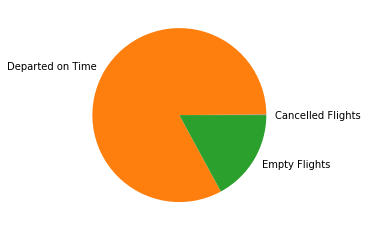

In [4]:
cancelled=df[(df['DEPARTURES_PERFORMED']==0)]
empty=df[df['PASSENGERS']==0]
empty_sum=len(empty)
cancelled_sum=len(cancelled)
departed=df[(df['DEPARTURES_PERFORMED']!=0)]
departed_sum=len(departed)
colors=["#000000","#FF0000",]
y=[cancelled_sum,departed_sum,empty_sum]
print(y)
labels='Cancelled Flights','Departed on Time','Empty Flights'
plt.pie(y, labels = labels)
plt.show()

[54, 39808, 8213]


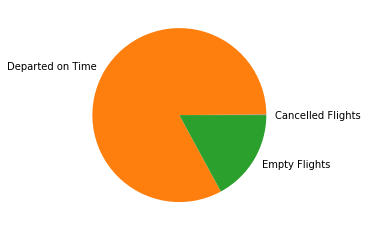

In [5]:
cancelled=df[(df['DEPARTURES_PERFORMED']==0)]
empty=df[df['PASSENGERS']==0]
empty_sum=len(empty)
cancelled_sum=len(cancelled)
departed=df[(df['DEPARTURES_PERFORMED']!=0)]
departed_sum=len(departed)
colors=["#000000","#FF0000",]
y=[cancelled_sum,departed_sum,empty_sum]
print(y)
labels='Cancelled Flights','Departed on Time','Empty Flights'
plt.pie(y, labels = labels)
plt.show()

In [6]:
df.columns
df1=df[(df['DEPARTURES_PERFORMED']==0)]
len(df1)

54

In [7]:
df_new= df[(df['DEPARTURES_PERFORMED']!=0) & df['PASSENGERS']!=0]

In [8]:
df_new

,DEPARTURES_PERFORMED,PASSENGERS,DISTANCE,UNIQUE_CARRIER,UNIQUE_CARRIER_NAME,CARRIER,CARRIER_NAME,ORIGIN_AIRPORT_ID,ORIGIN,DEST_AIRPORT_ID,DEST,AIRCRAFT_TYPE,MONTH
56,1,143,6584,AA,American Airlines Inc.,AA,American Airlines Inc.,15258,TLV,11697,FLL,627,2
60,1,159,746,AA,American Airlines Inc.,AA,American Airlines Inc.,13303,MIA,14207,POP,614,2
62,1,127,556,AA,American Airlines Inc.,AA,American Airlines Inc.,13303,MIA,11244,CZM,614,2
67,1,169,746,AA,American Airlines Inc.,AA,American Airlines Inc.,14207,POP,13303,MIA,614,2
70,1,43,2390,AA,American Airlines Inc.,AA,American Airlines Inc.,14832,SJD,11618,EWR,614,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...
39848,213,35093,1028,AA,American Airlines Inc.,AA,American Airlines Inc.,11298,DFW,11032,CUN,699,3
39849,222,1405,211,04Q,Tradewind Aviation,04Q,Tradewind Aviation,14843,SJU,14692,SBH,479,4
39851,235,1567,211,04Q,Tradewind Aviation,04Q,Tradewind Aviation,14692,SBH,14843,SJU,479,4
39852,249,1547,211,04Q,Tradewind Aviation,04Q,Tradewind Aviation,14843,SJU,14692,SBH,479,2


In [9]:
df_airline=df[['CARRIER','PASSENGERS']].groupby('CARRIER').sum().sort_values(by='PASSENGERS',ascending=False)
df_airline['CARRIER']=df_airline.index


In [10]:
df_airline
df_airline=df_airline.head(25)

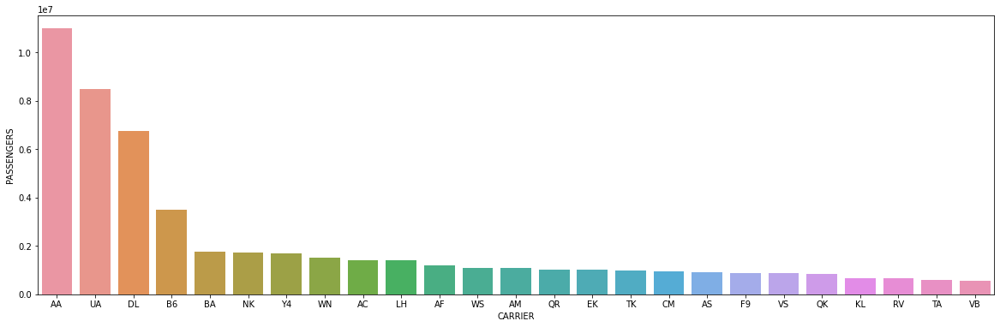

In [11]:
plt.figure(figsize=(20, 6))
sns.barplot(data=df_airline,x="CARRIER",y="PASSENGERS")

plt.show()

In [12]:
df_new['MONTH'].nunique()

5

<AxesSubplot:xlabel='MONTH'>

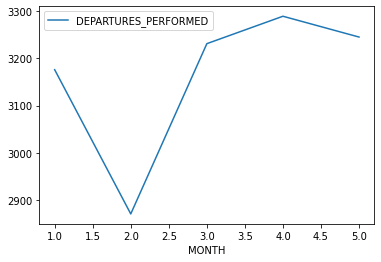

In [13]:
df_new[['MONTH',"DEPARTURES_PERFORMED"]].groupby(["MONTH"]).count().plot()

In [14]:
uni_df=df_new.drop_duplicates(['ORIGIN','DEST'])


In [15]:
gf= df_new[['ORIGIN','DEST','PASSENGERS']]

In [16]:


df2 = df_new.groupby(['ORIGIN','DEST'])['PASSENGERS'].sum()
df2


ORIGIN  DEST
ABE     BFS         7
ABJ     TEB         3
ACA     DFW       885
        IAH      5031
ACC     ATL       233
                ...  
ZRH     PVD         1
        SFO     15147
        SJC         1
        TEB        29
        TPA      1383
Name: PASSENGERS, Length: 3852, dtype: int64

In [17]:
ndf=df2.sort_values(ascending=False)
ndf

ORIGIN  DEST
JFK     LHR     228576
LHR     JFK     199531
JFK     CDG     145641
DXB     JFK     124547
STI     JFK     123695
                 ...  
FAB     HPN          1
MIA     SXB          1
FAB     JFK          1
        PSP          1
SJD     GEG          1
Name: PASSENGERS, Length: 3852, dtype: int64

In [19]:
#adjaceny matrix og dataset find the number of counts divided by the non unique routes 


In [20]:
uni_df
uni_df.to_csv('uni_df.csv')

In [21]:
ad_df = pd.crosstab(uni_df.ORIGIN, uni_df.DEST)
idx = ad_df.columns.union(ad_df.index)
ad_df = ad_df.reindex(index = idx, columns=idx, fill_value=0)
mat= np.asmatrix(ad_df)
mat

matrix([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]], dtype=int64)

In [22]:
 idx
l1= idx.copy()
l2= idx.copy()
l=[]
for i in l1:
    for j in l2:
        l.append([i,j])
l=idx.tolist()
l

['ABE',
 'ABJ',
 'ABQ',
 'ABV',
 'ABZ',
 'ACA',
 'ACC',
 'ACY',
 'ADB',
 'ADD',
 'ADS',
 'ADZ',
 'AEX',
 'AFW',
 'AGP',
 'AGS',
 'AGU',
 'AHN',
 'AKL',
 'ALB',
 'ALC',
 'AMD',
 'AMM',
 'AMS',
 'ANC',
 'ANR',
 'ANU',
 'APA',
 'APF',
 'APW',
 'ARN',
 'ASD',
 'ASE',
 'ATH',
 'ATL',
 'ATQ',
 'AUA',
 'AUH',
 'AUS',
 'AXA',
 'AXM',
 'AYT',
 'AZA',
 'AZI',
 'AZS',
 'BAH',
 'BAQ',
 'BCN',
 'BCT',
 'BDA',
 'BDL',
 'BED',
 'BEG',
 'BER',
 'BFI',
 'BFM',
 'BFS',
 'BGA',
 'BGI',
 'BGR',
 'BHD',
 'BHM',
 'BHX',
 'BIM',
 'BJC',
 'BJV',
 'BJX',
 'BLL',
 'BLR',
 'BMA',
 'BNA',
 'BNE',
 'BOG',
 'BOI',
 'BOM',
 'BON',
 'BOS',
 'BQH',
 'BQK',
 'BQU',
 'BRN',
 'BRO',
 'BRS',
 'BRU',
 'BS1',
 'BS3',
 'BSB',
 'BTS',
 'BTV',
 'BUD',
 'BUF',
 'BUR',
 'BWE',
 'BWI',
 'BZE',
 'BZN',
 'C01',
 'CAI',
 'CAN',
 'CAP',
 'CAT',
 'CCZ',
 'CDG',
 'CEB',
 'CGN',
 'CHC',
 'CHO',
 'CHS',
 'CIA',
 'CIW',
 'CLD',
 'CLE',
 'CLO',
 'CLT',
 'CMA',
 'CMF',
 'CMH',
 'CMN',
 'CNF',
 'COO',
 'COS',
 'COU',
 'CPC',
 'CPH',
 'CPS',


In [23]:
a=df_new[['ORIGIN','DEST']].values.tolist()
adj=mat.tolist()
s=len(idx)
w=[[0 for i in range(s)] for j in range(s)]
for i in range(len(l)):
    for j in range(len(l)):
        if adj[i][j]==1:
            w[i][j]=(a.count([l[i],l[j]]))/len(a)

In [24]:
w

[[0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  6.324310650139134e-05,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,


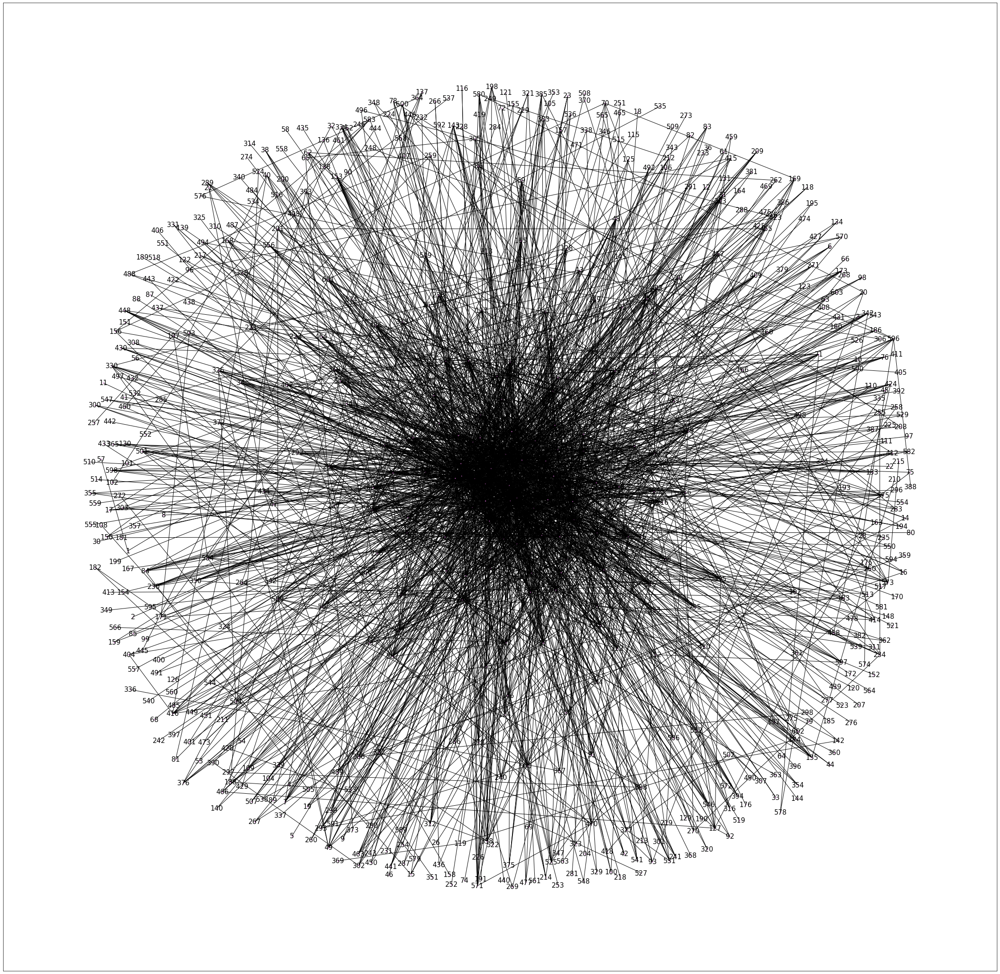

Graph with 604 nodes and 2425 edges


<Figure size 432x288 with 0 Axes>

In [25]:
def adj_to_edges(adj):
    for i in range(len(adj)):
        for j in range(len(adj[0])):
            if adj[i][j]==1:
                g.add_edge(i+1,j+1,weight=w[i][j])           
    
    return nodes

g=nx.Graph()
nodes=[]
nodes=adj_to_edges(adj)
#print(g.edges)
airport_g=nx.spring_layout(g) 
plt.figure(figsize=(40,40))
nx.draw_networkx_nodes(g,airport_g,node_color='#DA70D6',
                           node_size=2,alpha=0.8)

nx.draw_networkx_labels(g, airport_g, font_size=15, 
                            font_family='sans-serif')

nx.draw_networkx_edges(g, airport_g,style='solid')
plt.show()
plt.savefig("graph.png")

print(g)
#print(g.edges)

{1: 'ABE', 2: 'ABJ', 3: 'ABQ', 4: 'ABV', 5: 'ABZ', 6: 'ACA', 7: 'ACC', 8: 'ACY', 9: 'ADB', 10: 'ADD', 11: 'ADS', 12: 'ADZ', 13: 'AEX', 14: 'AFW', 15: 'AGP', 16: 'AGS', 17: 'AGU', 18: 'AHN', 19: 'AKL', 20: 'ALB', 21: 'ALC', 22: 'AMD', 23: 'AMM', 24: 'AMS', 25: 'ANC', 26: 'ANR', 27: 'ANU', 28: 'APA', 29: 'APF', 30: 'APW', 31: 'ARN', 32: 'ASD', 33: 'ASE', 34: 'ATH', 35: 'ATL', 36: 'ATQ', 37: 'AUA', 38: 'AUH', 39: 'AUS', 40: 'AXA', 41: 'AXM', 42: 'AYT', 43: 'AZA', 44: 'AZI', 45: 'AZS', 46: 'BAH', 47: 'BAQ', 48: 'BCN', 49: 'BCT', 50: 'BDA', 51: 'BDL', 52: 'BED', 53: 'BEG', 54: 'BER', 55: 'BFI', 56: 'BFM', 57: 'BFS', 58: 'BGA', 59: 'BGI', 60: 'BGR', 61: 'BHD', 62: 'BHM', 63: 'BHX', 64: 'BIM', 65: 'BJC', 66: 'BJV', 67: 'BJX', 68: 'BLL', 69: 'BLR', 70: 'BMA', 71: 'BNA', 72: 'BNE', 73: 'BOG', 74: 'BOI', 75: 'BOM', 76: 'BON', 77: 'BOS', 78: 'BQH', 79: 'BQK', 80: 'BQU', 81: 'BRN', 82: 'BRO', 83: 'BRS', 84: 'BRU', 85: 'BS1', 86: 'BS3', 87: 'BSB', 88: 'BTS', 89: 'BTV', 90: 'BUD', 91: 'BUF', 92: 'BU

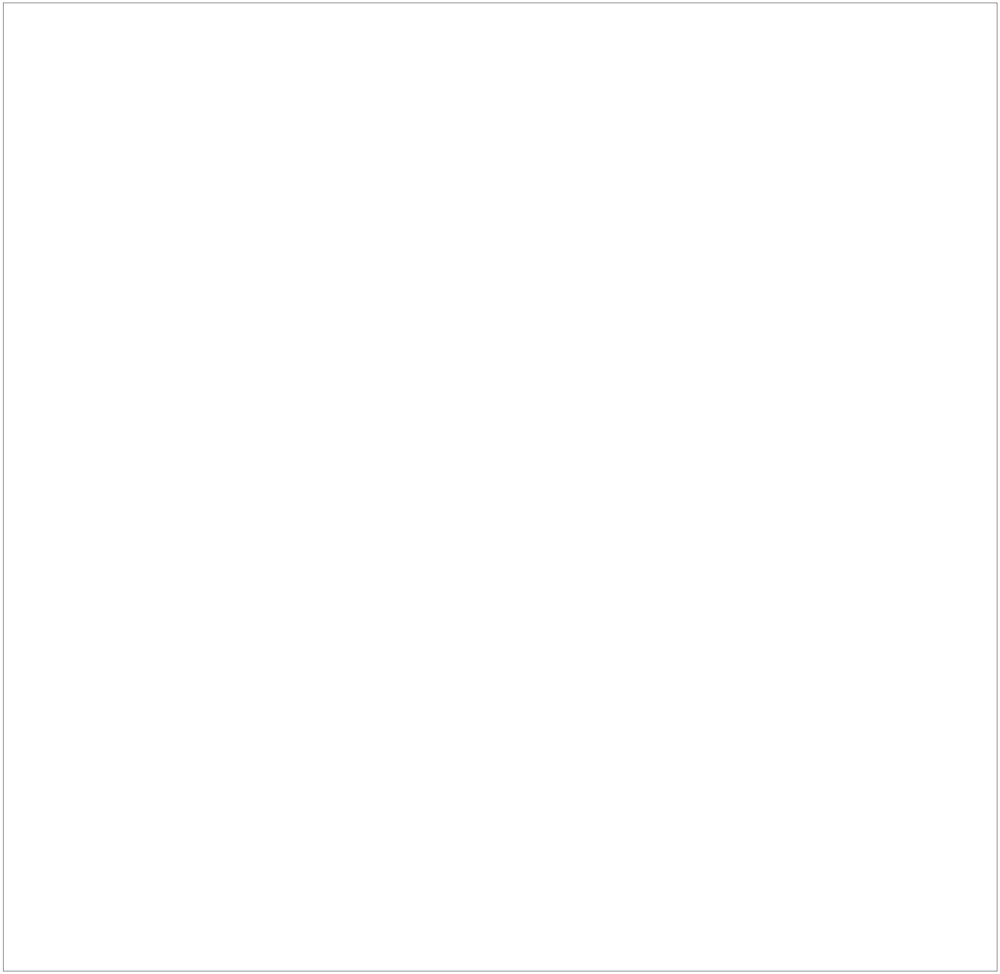

<Figure size 432x288 with 0 Axes>

In [26]:
g=nx.Graph()
airport_g=nx.spring_layout(g)

#relabel nodes
airport_values=l;
airport_values=np.array(airport_values)


mapping=dict(zip(range(1,605),airport_values));
print(mapping)
g=nx.relabel_nodes(g,mapping);
g.edges(data=True);


plt.figure(figsize=(40,40))
nx.draw_networkx_nodes(g,airport_g,node_color='#DA70D6',
                           node_size=2,alpha=0.8)

nx.draw_networkx_labels(g, airport_g, font_size=15, 
                            font_family='sans-serif')

nx.draw_networkx_edges(g, airport_g,style='solid')
plt.show()
plt.savefig("graph.png")

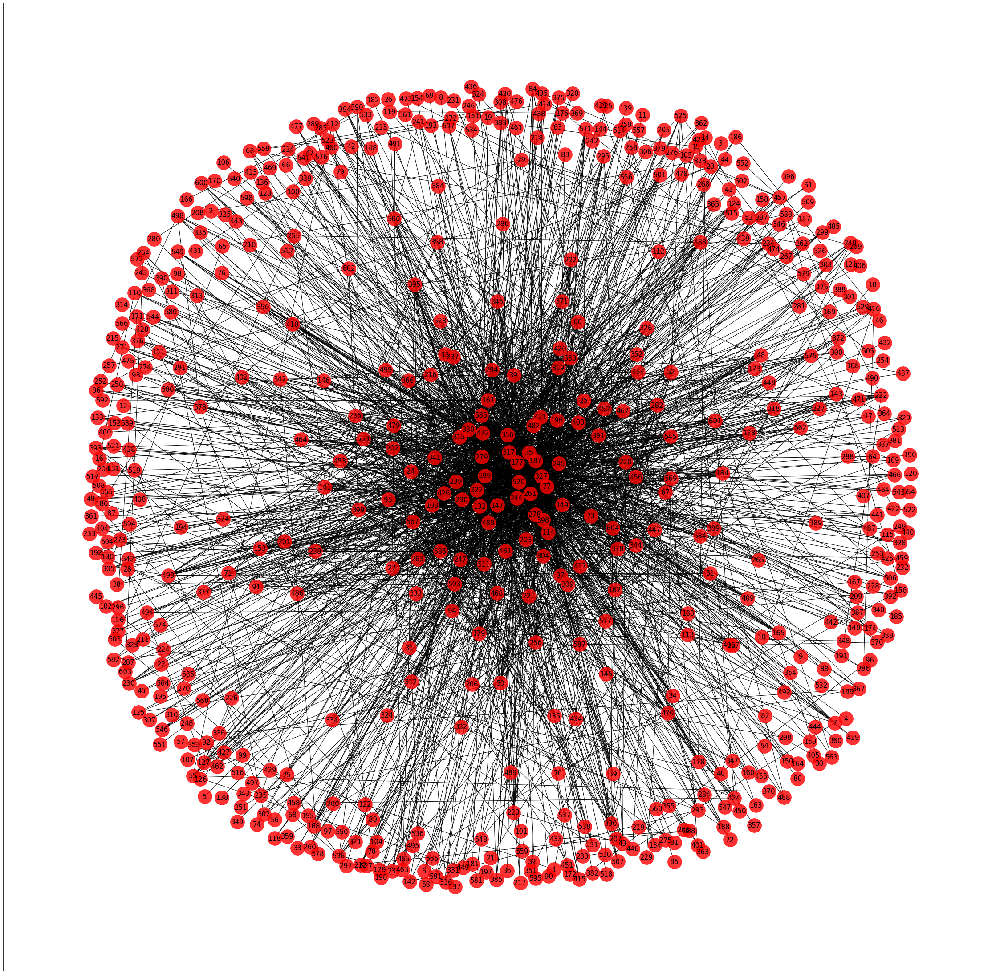

Graph with 604 nodes and 2425 edges


<Figure size 432x288 with 0 Axes>

In [30]:
def adj_to_edges(adj):
    for i in range(len(adj)):
        for j in range(len(adj[0])):
            if adj[i][j]==1:
                g.add_edge(i+1,j+1,weight=w[i][j])           
    
    return nodes

g=nx.Graph()
nodes=[]
nodes=adj_to_edges(adj)
#print(g.edges)
airport_g=nx.spring_layout(g) 
plt.figure(figsize=(40,40))
nx.draw_networkx_nodes(g,airport_g,node_color='#FF0000',
                           node_size=1000,alpha=0.8)

nx.draw_networkx_labels(g, airport_g, font_size=15, 
                            font_family='sans-serif')

nx.draw_networkx_edges(g, airport_g,style='solid')
plt.show()
plt.savefig("graph.png")

print(g)
#print(g.edges)

In [31]:
air_dict=dict(g.degree(weight='weight'))

In [32]:
max_air = max(zip(air_dict.values(), air_dict.keys()))[1]
print(max_air)

327


In [33]:
air_list=[]
for i in air_dict:
    air_list.append((i,air_dict[i]))
n=len(air_list)
for i in range(n-1):
    for j in range(n-1-i):
        if air_list[j][1]<air_list[j+1][1]:
            air_list[j],air_list[j+1]=air_list[j+1],air_list[j]
print(air_list)

[(327, 0.04623071085251705), (261, 0.04300531242094609), (279, 0.037819377687832015), (599, 0.03781937768783199), (132, 0.030483177333670636), (187, 0.026941563369592723), (380, 0.024981027068049586), (177, 0.023969137364027327), (245, 0.021439413103971676), (35, 0.019162661269921586), (317, 0.018972931950417417), (472, 0.017328611181381244), (149, 0.01663293700986593), (244, 0.016063749051353413), (322, 0.015874019731849234), (77, 0.015304831773336722), (290, 0.015115102453832534), (480, 0.013913483430306104), (586, 0.01378699721730332), (585, 0.013028079939286629), (356, 0.012142676448267149), (203, 0.011763217809258791), (315, 0.011447002276751835), (426, 0.011383759170250444), (421, 0.010308626359726793), (593, 0.009992410827219841), (196, 0.009802681507715662), (398, 0.009233493549203137), (114, 0.008980521123197574), (147, 0.008790791803693397), (520, 0.008348090058183655), (24, 0.008221603845180876), (468, 0.008031874525676703), (103, 0.008031874525676701), (278, 0.0079053883126

In [54]:
for i in mapping:
    if mapping[i]=='ICN':
        print(g.degree(i))

5


In [34]:
top=[air_list[i][0] for i in range(4)]
top

[327, 261, 279, 599]

In [35]:
top_ten=[air_list[i][0] for i in range(10)]
top_ten

[327, 261, 279, 599, 132, 187, 380, 177, 245, 35]

In [36]:
for j in top_ten:
    print(mapping[j])

MIA
JFK
LAX
YYZ
CUN
FLL
ORD
EWR
IAH
ATL


In [37]:
color_map=[]
node_size=[]
for node in g:
    if node in top:
        color_map.append('#8ae')
        node_size.append(5000)
    else:
        color_map.append('red')
        node_size.append(1000)


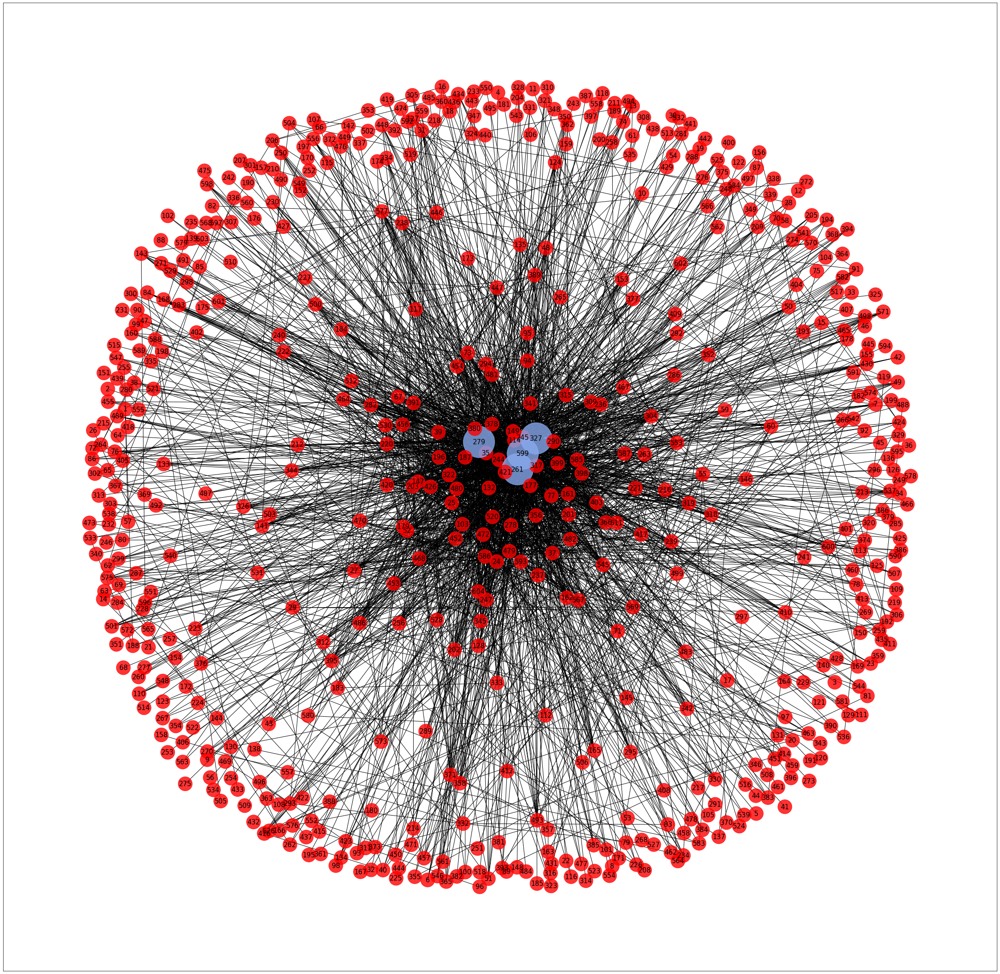

Graph with 604 nodes and 2425 edges


<Figure size 432x288 with 0 Axes>

In [38]:
def adj_to_edges(adj):
    for i in range(len(adj)):
        for j in range(len(adj[0])):
            if adj[i][j]==1:
                g.add_edge(i+1,j+1,weight=w[i][j])           
    
    return nodes

g=nx.Graph()
nodes=[]
nodes=adj_to_edges(adj)
#print(g.edges)
airport_g=nx.spring_layout(g) 
plt.figure(figsize=(40,40))
nx.draw_networkx_nodes(g,airport_g,node_color=color_map,
                           node_size=node_size,alpha=0.8)

nx.draw_networkx_labels(g, airport_g, font_size=15, 
                            font_family='sans-serif')

nx.draw_networkx_edges(g, airport_g,style='solid')
plt.show()
plt.savefig("graph.png")

print(g)
#print(g.edges)

In [39]:
top_val=[]
for i in top:
    top_val.append(i)
    print(mapping[i])

MIA
JFK
LAX
YYZ


In [40]:
for i in top:
    print(g.degree(i))

122
119
108
110


In [41]:
min_list=[]
min_air = min(zip(air_dict.values(), air_dict.keys()))[1]
print(min_air)
#print(air_dict)
for i in air_dict:
    if air_dict[i]==air_dict[min_air]:
        min_list.append(mapping[i])

2


In [42]:
min_list;

In [43]:
len(min_list)

171

In [44]:
wait=np.array(df_new['ORIGIN'])
wait

array(['TLV', 'MIA', 'MIA', ..., 'SBH', 'SJU', 'YTZ'], dtype=object)

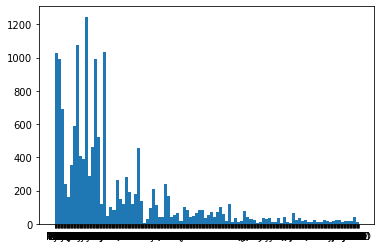

In [45]:
plt.hist(wait,bins=100)
plt.show()

In [46]:

df_updated=uni_df[(uni_df['ORIGIN']!='JFK') & (uni_df['ORIGIN']!='YYZ') & (uni_df['ORIGIN']!='MIA') & (uni_df['ORIGIN']!='LAX')&(uni_df['ORIGIN']!='CUN')&(uni_df['ORIGIN']!='FLL')&(uni_df['ORIGIN']!='ORD')&(uni_df['ORIGIN']!='EWR')&(uni_df['ORIGIN']!='IAH')&(uni_df['ORIGIN']!='ATL')]

In [47]:
df_updated

,DEPARTURES_PERFORMED,PASSENGERS,DISTANCE,UNIQUE_CARRIER,UNIQUE_CARRIER_NAME,CARRIER,CARRIER_NAME,ORIGIN_AIRPORT_ID,ORIGIN,DEST_AIRPORT_ID,DEST,AIRCRAFT_TYPE,MONTH
56,1,143,6584,AA,American Airlines Inc.,AA,American Airlines Inc.,15258,TLV,11697,FLL,627,2
67,1,169,746,AA,American Airlines Inc.,AA,American Airlines Inc.,14207,POP,13303,MIA,614,2
70,1,43,2390,AA,American Airlines Inc.,AA,American Airlines Inc.,14832,SJD,11618,EWR,614,2
71,1,159,2184,AA,American Airlines Inc.,AA,American Airlines Inc.,14832,SJD,12264,IAD,614,2
72,1,61,2539,AA,American Airlines Inc.,AA,American Airlines Inc.,11888,GEO,12478,JFK,614,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...
39215,79,375,29,9K,Cape Air,9K,Cape Air,15024,STT,11519,EIS,125,2
39483,91,16085,1040,AA,American Airlines Inc.,AA,American Airlines Inc.,11057,CLT,11032,CUN,699,4
39562,96,4021,434,PD,"Porter Airlines, Inc.",PD,"Porter Airlines, Inc.",10721,BOS,16215,YTZ,482,4
39589,100,1769,6274,NH,All Nippon Airways Co.,NH,All Nippon Airways Co.,13744,NRT,13930,ORD,637,2


In [48]:
ad_df = pd.crosstab(df_updated.ORIGIN, df_updated.DEST)
idx = ad_df.columns.union(ad_df.index)
ad_df = ad_df.reindex(index = idx, columns=idx, fill_value=0)
mat= np.asmatrix(ad_df)
mat

matrix([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]], dtype=int64)

In [49]:
idx
l1= idx.copy()
l2= idx.copy()
l=[]
for i in l1:
    for j in l2:
        l.append([i,j])
l=idx.tolist()
l

['ABE',
 'ABJ',
 'ABQ',
 'ABV',
 'ACA',
 'ACC',
 'ACY',
 'ADD',
 'ADS',
 'ADZ',
 'AEX',
 'AFW',
 'AGP',
 'AGS',
 'AGU',
 'AHN',
 'AKL',
 'ALB',
 'ALC',
 'AMM',
 'AMS',
 'ANC',
 'ANR',
 'ANU',
 'APA',
 'APF',
 'APW',
 'ARN',
 'ASD',
 'ASE',
 'ATH',
 'ATL',
 'AUA',
 'AUH',
 'AUS',
 'AXA',
 'AXM',
 'AZA',
 'AZI',
 'AZS',
 'BAQ',
 'BCN',
 'BCT',
 'BDA',
 'BDL',
 'BED',
 'BEG',
 'BER',
 'BFI',
 'BFS',
 'BGA',
 'BGI',
 'BGR',
 'BHD',
 'BHM',
 'BHX',
 'BIM',
 'BJC',
 'BJV',
 'BJX',
 'BLL',
 'BLR',
 'BMA',
 'BNA',
 'BNE',
 'BOG',
 'BOI',
 'BOM',
 'BON',
 'BOS',
 'BQH',
 'BQK',
 'BQU',
 'BRN',
 'BRO',
 'BRS',
 'BRU',
 'BS1',
 'BS3',
 'BSB',
 'BTS',
 'BTV',
 'BUD',
 'BUF',
 'BUR',
 'BWE',
 'BWI',
 'BZE',
 'BZN',
 'C01',
 'CAI',
 'CAN',
 'CAP',
 'CAT',
 'CCZ',
 'CDG',
 'CGN',
 'CHC',
 'CHO',
 'CHS',
 'CIA',
 'CIW',
 'CLD',
 'CLE',
 'CLO',
 'CLT',
 'CMA',
 'CMF',
 'CMH',
 'CMN',
 'CNF',
 'COO',
 'COS',
 'COU',
 'CPC',
 'CPH',
 'CPS',
 'CPT',
 'CSL',
 'CTG',
 'CTM',
 'CUF',
 'CUL',
 'CUN',
 'CUR',


In [50]:
a=df_updated[['ORIGIN','DEST']].values.tolist()
adj=mat.tolist()
s=len(idx)
w=[[0 for i in range(s)] for j in range(s)]
for i in range(len(l)):
    for j in range(len(l)):
        if adj[i][j]==1:
            w[i][j]=(a.count([l[i],l[j]]))/len(a)

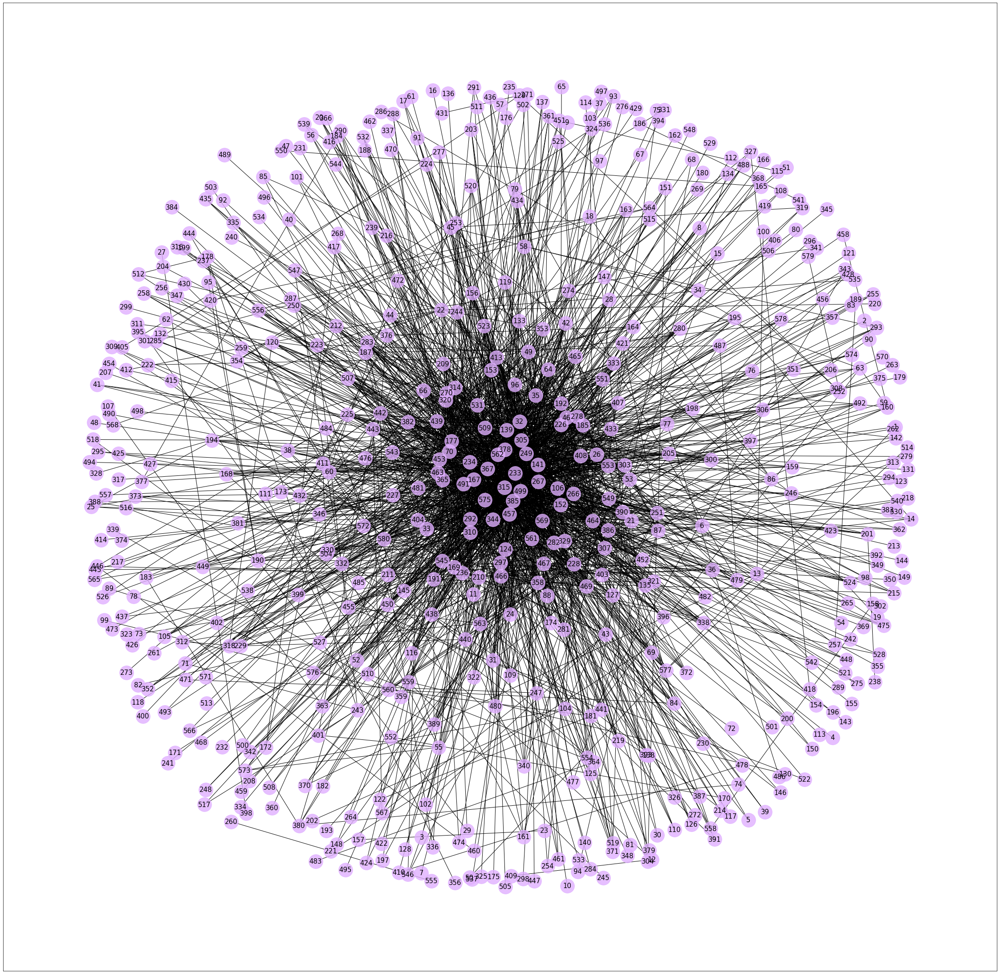

Graph with 580 nodes and 2310 edges


<Figure size 432x288 with 0 Axes>

In [51]:
def adj_to_edges(adj):
    for i in range(len(adj)):
        for j in range(len(adj[0])):
            if adj[i][j]==1:
                g.add_edge(i+1,j+1,weight=w[i][j])           
    
    return nodes

g=nx.Graph()
nodes=[]
nodes=adj_to_edges(adj)
#print(g.edges)
airport_g=nx.spring_layout(g) 
plt.figure(figsize=(40,40))
nx.draw_networkx_nodes(g,airport_g,node_color='#E0B0FF',
                           node_size=1000,alpha=0.8)

nx.draw_networkx_labels(g, airport_g, font_size=15, 
                            font_family='sans-serif')

nx.draw_networkx_edges(g, airport_g,style='solid')
plt.show()
plt.savefig("graph.png")

print(g)
#print(g.edges)

In [ ]:
df_pivot=pd.pivot_table(df_new,index='CARRIER_NAME',columns=['ORIGIN'],values=['ORIGIN'],aggfunc='count')
df_pivot